0k_29 images
     shear rate  eccentricity  convex_area  major_axis_length  \
0           0.0      0.825802         31.0           8.134746   
1           0.0      0.805504         53.0          10.428318   
2           0.0      0.837421         28.0           7.793800   
3           0.0      0.802286         31.0           7.839319   
4           0.0      0.861723         31.0           8.306929   
5           0.0      0.892727         22.0           7.595454   
6           0.0      0.876329         44.0          10.282629   
7           0.0      0.891431         61.0          12.527890   
8           0.0      0.861284         40.0           9.533924   
9           0.0      0.832255        332.0          26.420877   
10          0.0      0.800265         48.0           9.788423   
11          0.0      0.837300        238.0          22.847365   
12          0.0      0.937127         46.0          12.222895   
13          0.0      0.836409         54.0          10.947742   
14          

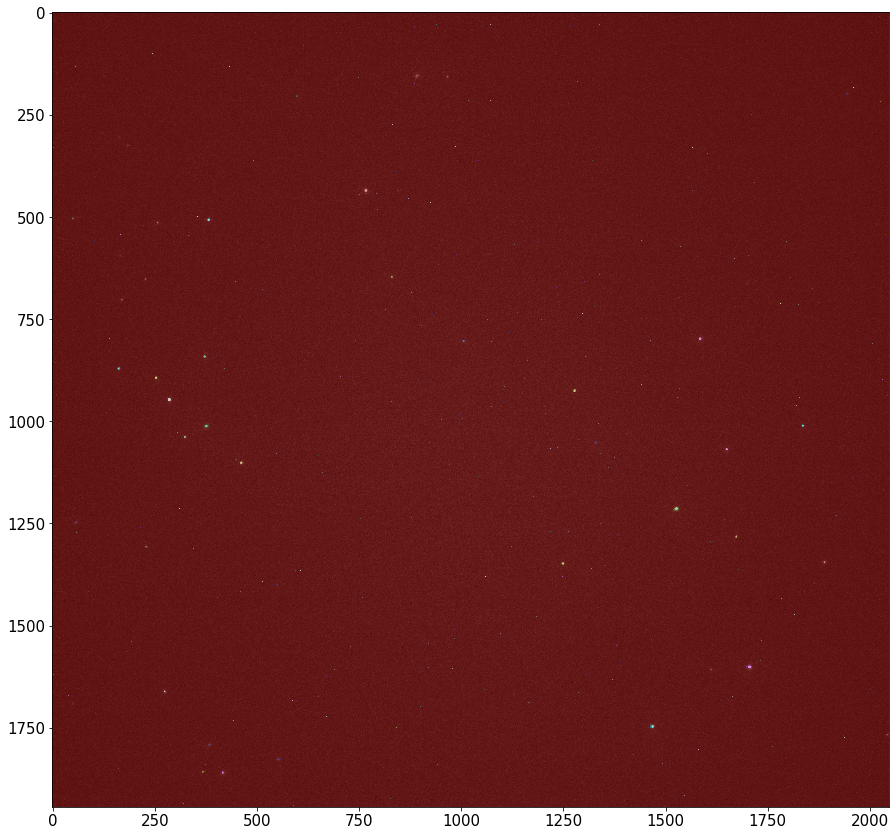

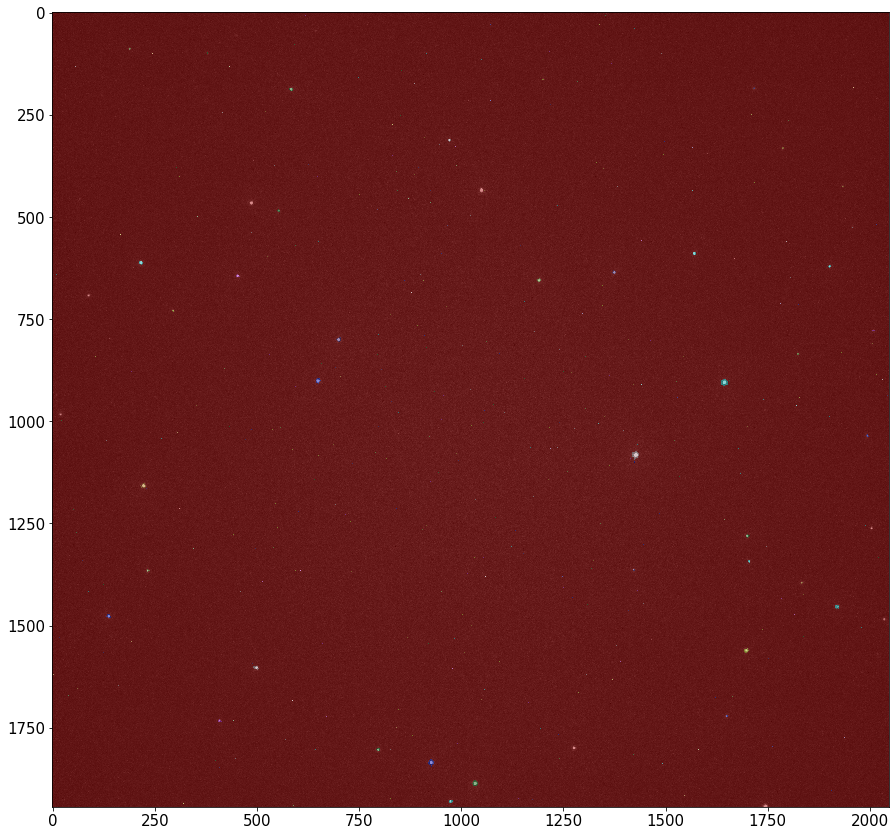

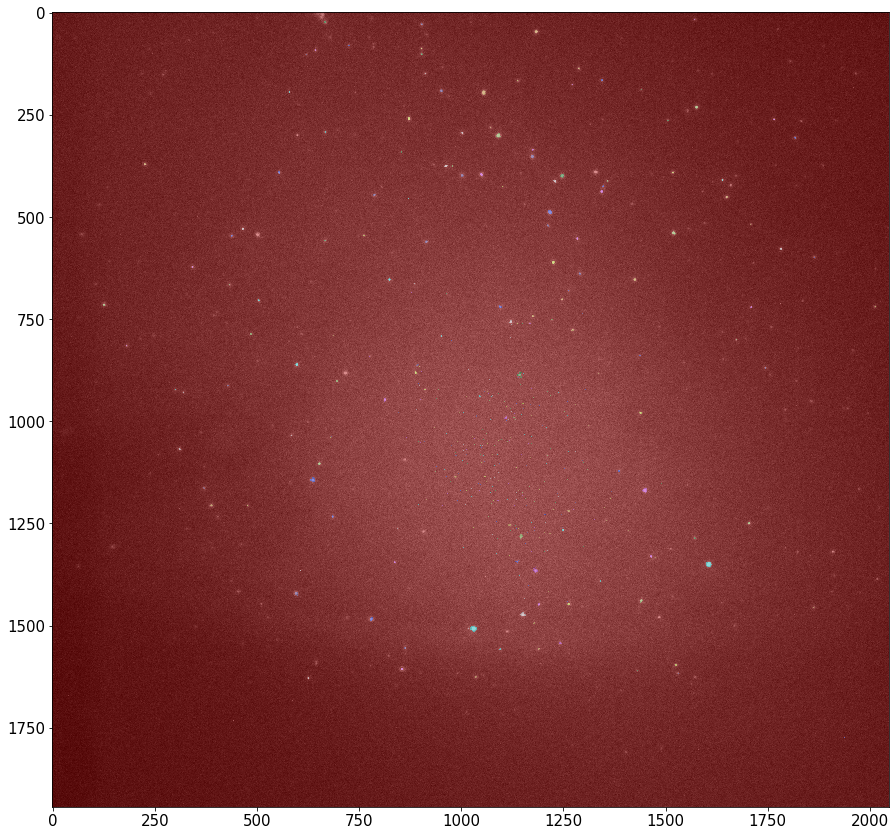

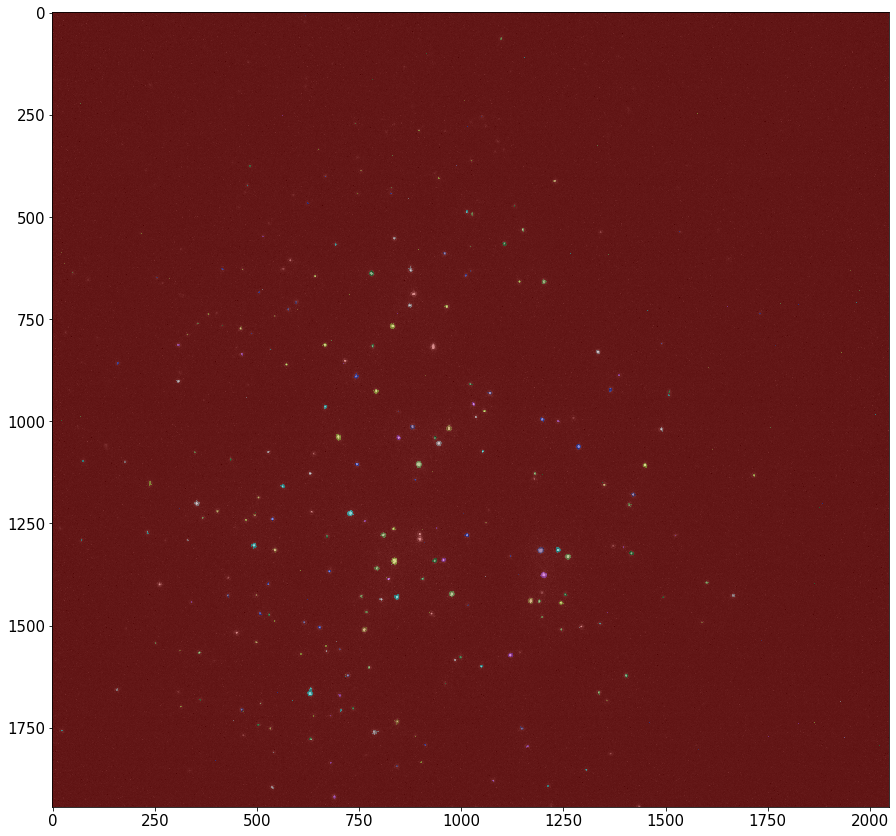

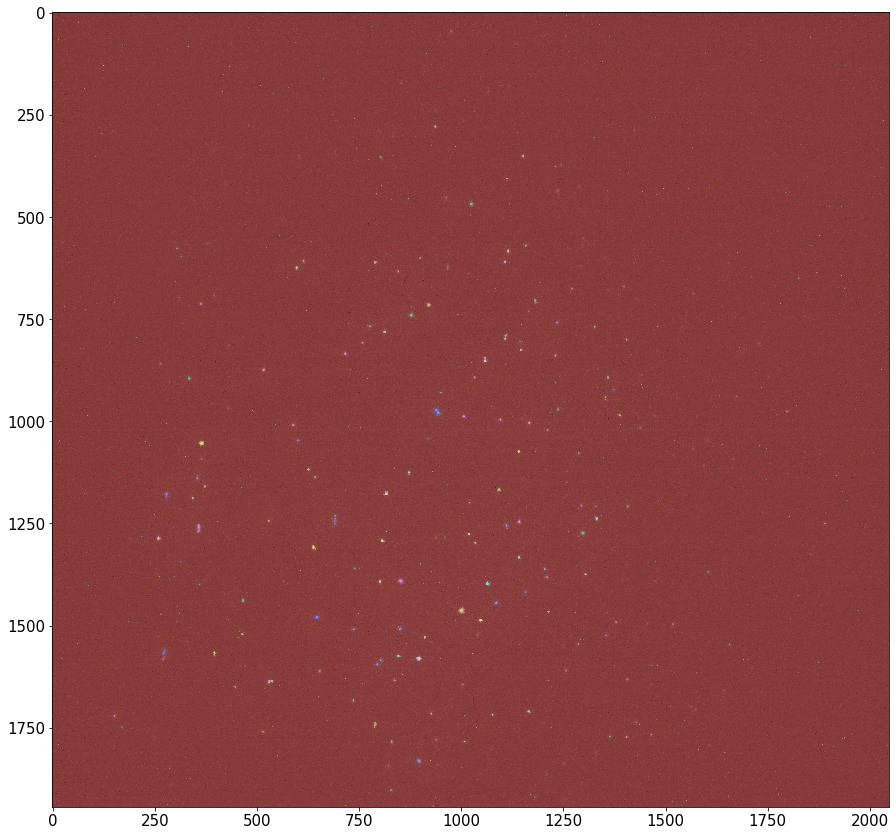

...

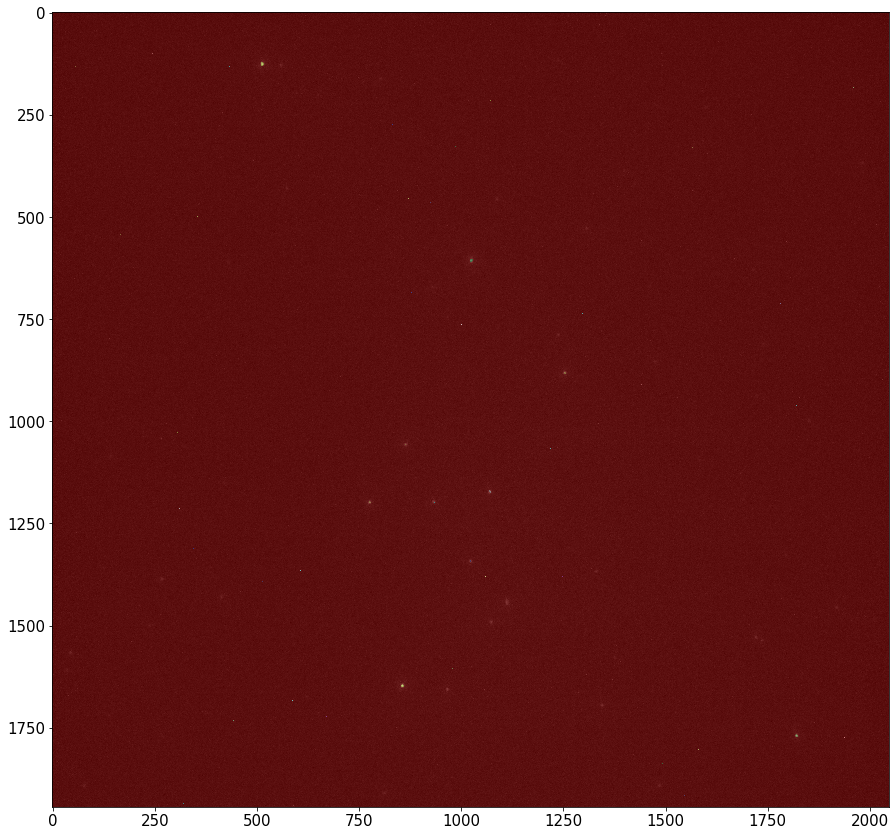

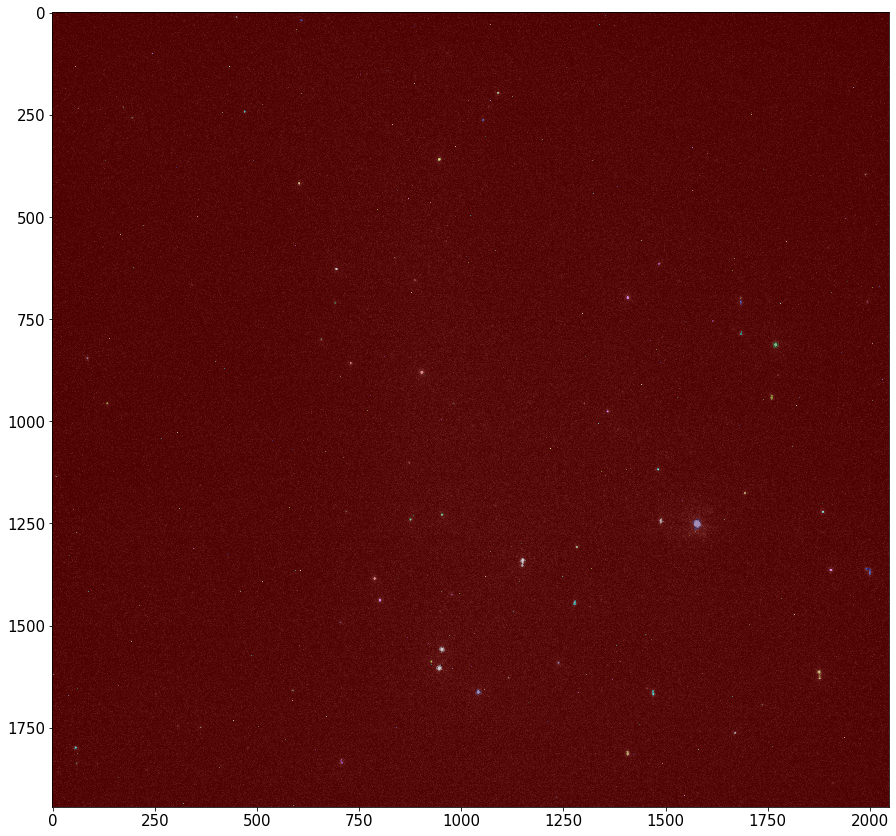

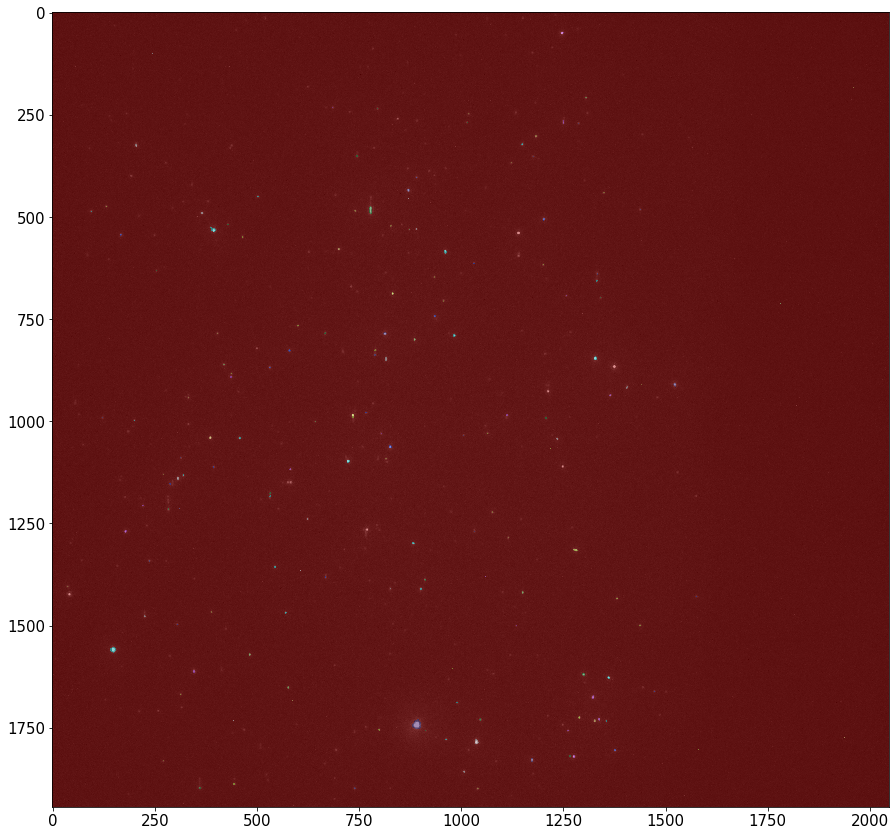

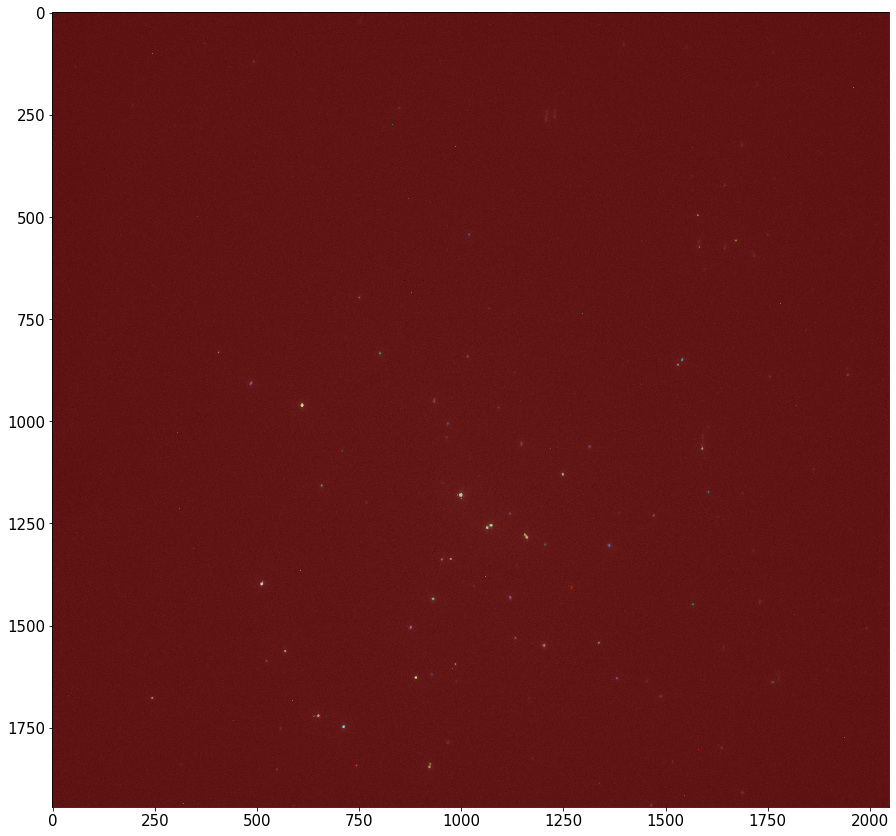

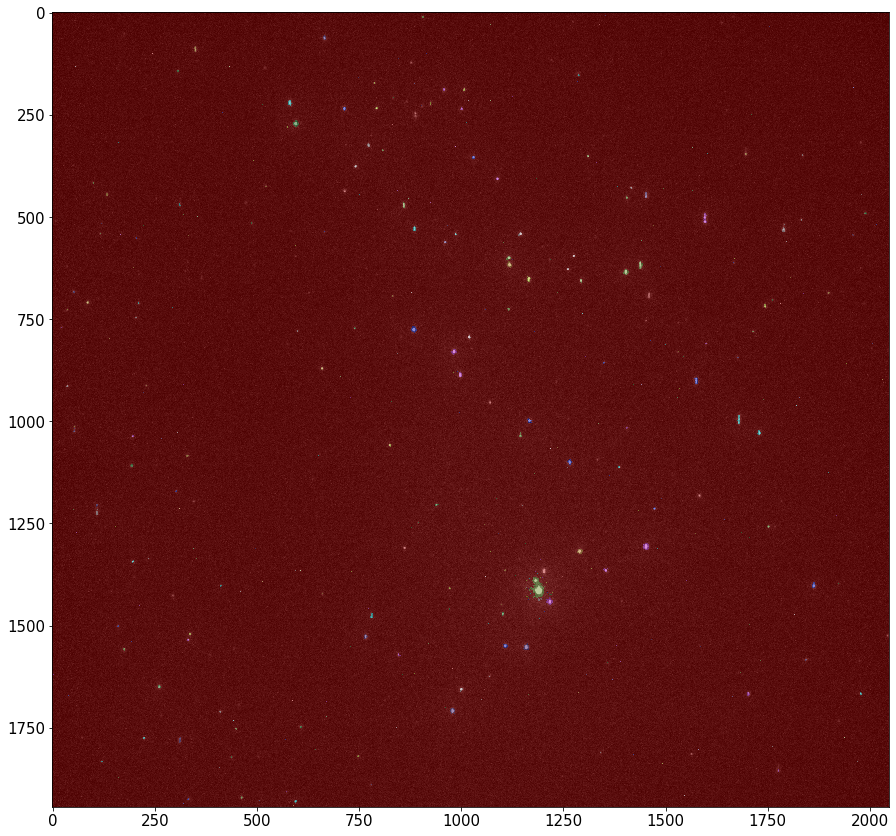

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
  
from PIL import Image
from pylab import *
from pathlib import Path
from skimage.color import rgb2gray
from skimage.measure import label, regionprops
from skimage.filters import threshold_yen
from skimage.morphology import closing, square
from skimage.segmentation import clear_border
from skimage.color import label2rgb
%matplotlib inline

shear_rate_0k = pd.DataFrame(columns=['shear rate', 'eccentricity', 'convex_area',
                                      'major_axis_length','minor_axis_length','orientation'])

# iterate over all images in a certain folder
pathlist = Path('Raw data_All images/0k_29 images/yen').glob('**/*.jpg')
for path in pathlist:
    path_in_str = str(path)
#    print(path_in_str)
    
    # open the image
    image = Image.open(path_in_str)
    
    # crop out scale bar
    width, height = image.size
    left = 0
    top = 0
    right = width
    bottom = height-100
    im1 = image.crop((left, top, right, bottom)) 
#    im1.show()
    
    # apply threshold
    img_array = np.array(im1)
    image_gray = rgb2gray(img_array)
    image = image_gray
    thresh = threshold_yen(image)
    binary = image <= thresh
    bw = closing(image > thresh, square(3))
    plt.rcParams.update({'font.size': 15})
#    plt.figure(figsize = (15,15))
#    imshow(binary,cmap=plt.cm.gray)
    
    # remove artifacts connected to image border
    cleared = clear_border(bw)
    
    # label image regions
    label_image = label(cleared)
    image_label_overlay = label2rgb(label_image, image=image)
    fig, ax = plt.subplots(figsize=(15, 15))
    ax.imshow(image_label_overlay)
    
    # extract features
    props = regionprops(label_image,intensity_image=image_gray, coordinates='xy')
    
    for i in props: 
        # exclude circular(folded) and small(might be background noise) dots
        if i.eccentricity>.8 and i.convex_area>20:                                
            shear_rate_0k = shear_rate_0k.append({'shear rate': 0, 'eccentricity': i.eccentricity, 
                                                    'convex_area': i.convex_area,'major_axis_length': i.major_axis_length,
                                                   'minor_axis_length': i.minor_axis_length,'orientation': i.orientation},
                                                   ignore_index=True)

print("0k_29 images", shear_rate_0k, sep='\n')

0k_29 images
     shear rate  eccentricity  convex_area  major_axis_length  \
0           0.0      0.825802         31.0           8.134746   
1           0.0      0.805504         53.0          10.428318   
2           0.0      0.837421         28.0           7.793800   
3           0.0      0.802286         31.0           7.839319   
4           0.0      0.861723         31.0           8.306929   
5           0.0      0.892727         22.0           7.595454   
6           0.0      0.876329         44.0          10.282629   
7           0.0      0.891431         61.0          12.527890   
8           0.0      0.861284         40.0           9.533924   
9           0.0      0.832255        332.0          26.420877   
10          0.0      0.800265         48.0           9.788423   
11          0.0      0.837300        238.0          22.847365   
12          0.0      0.937127         46.0          12.222895   
13          0.0      0.836409         54.0          10.947742   
14          

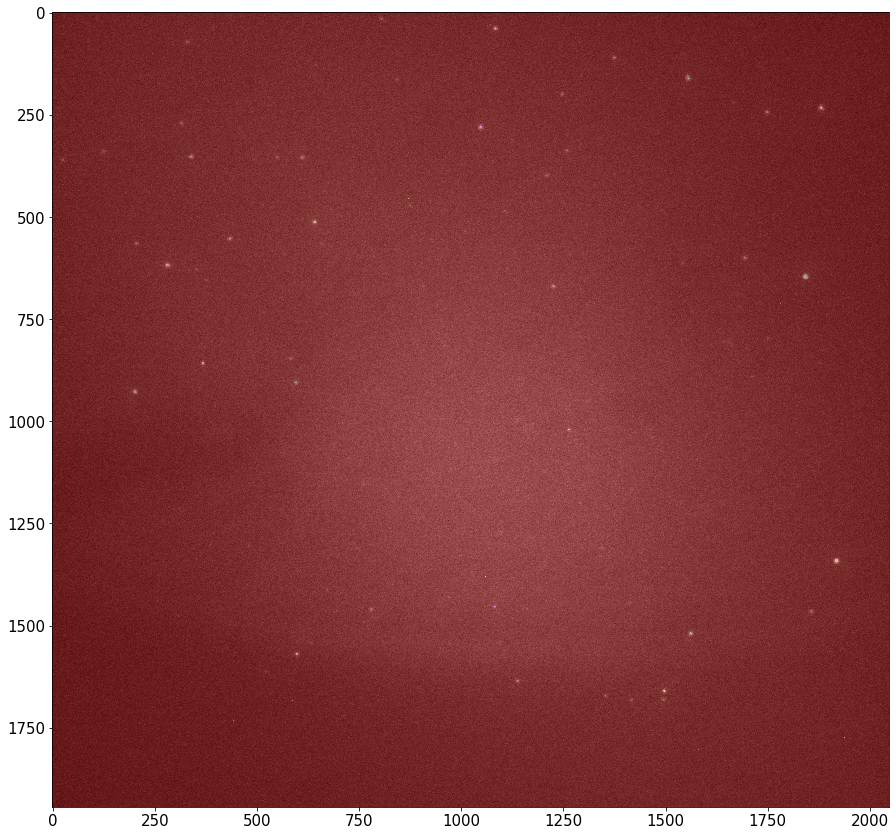

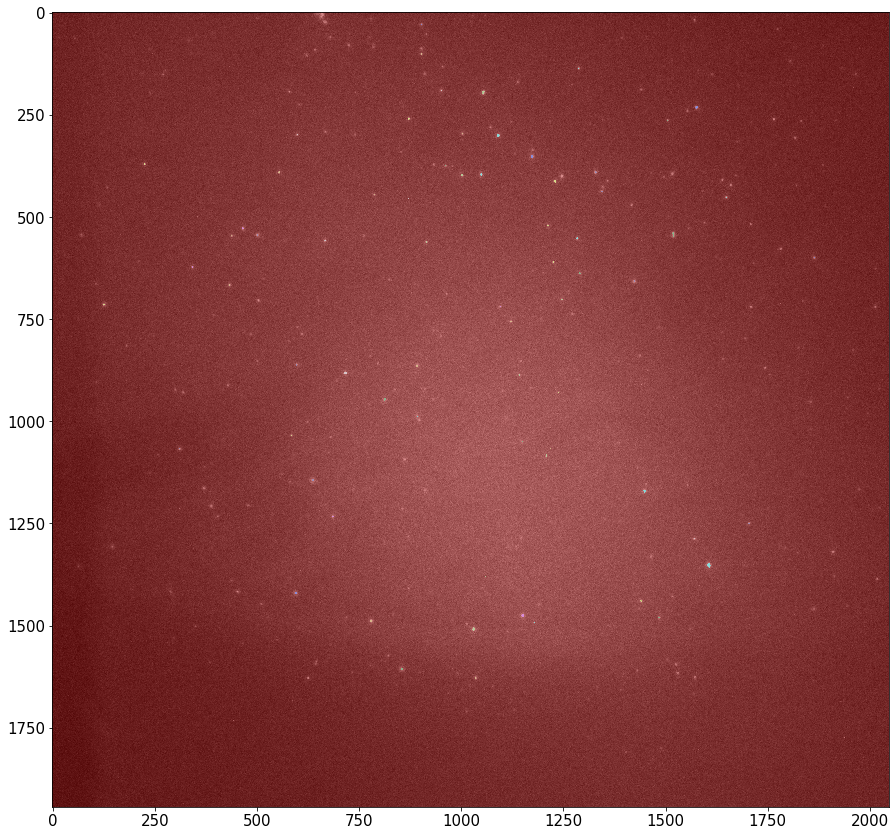

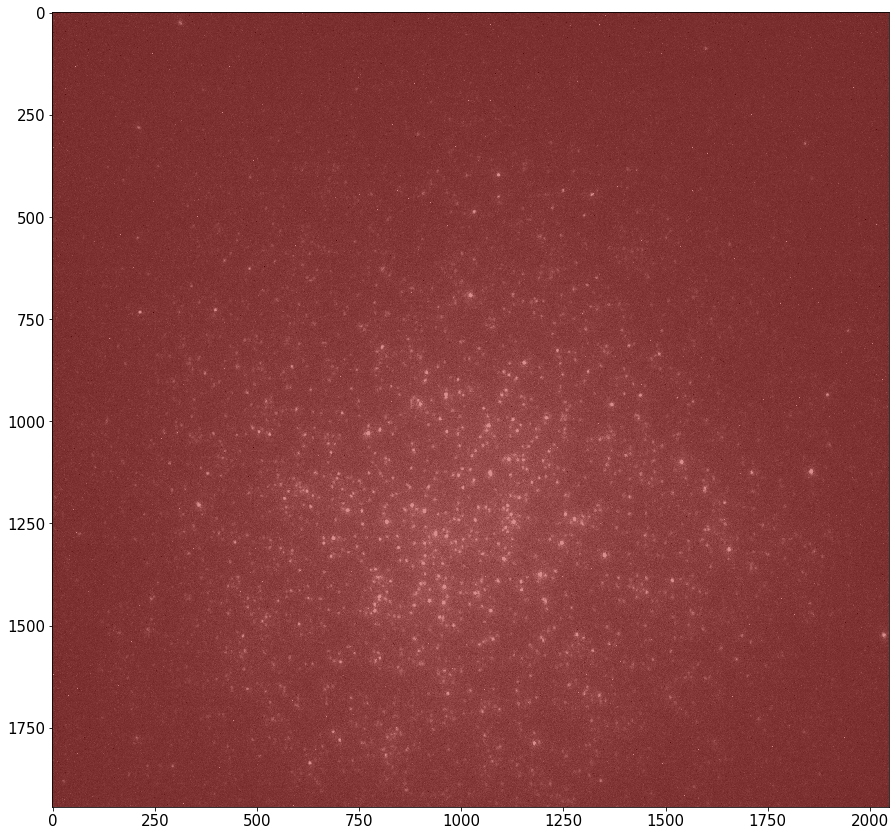

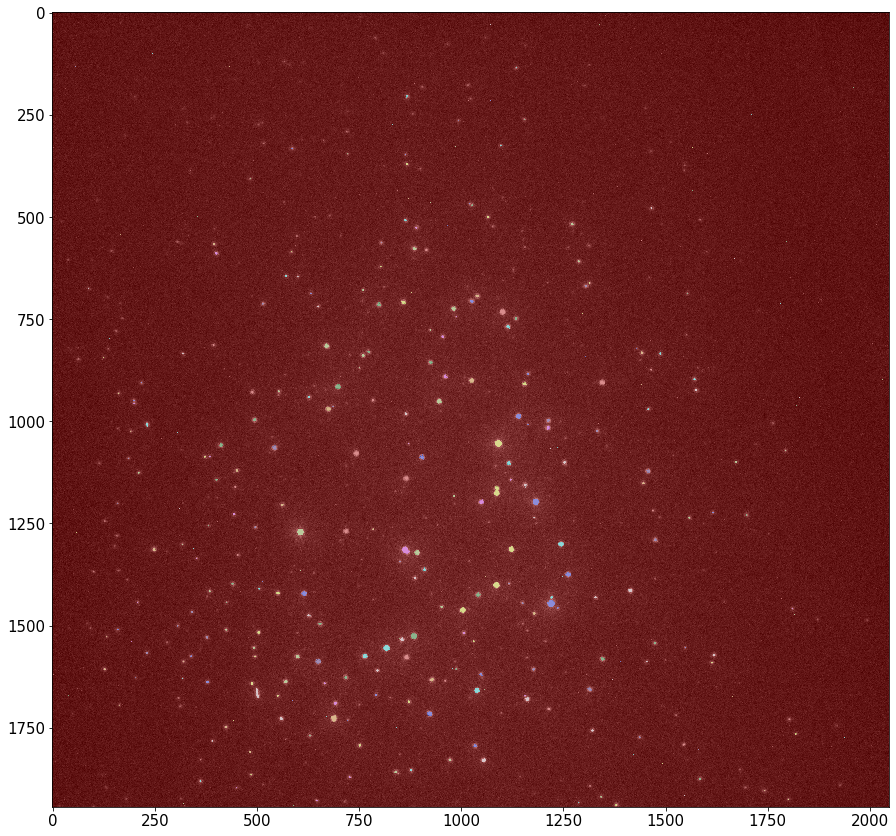

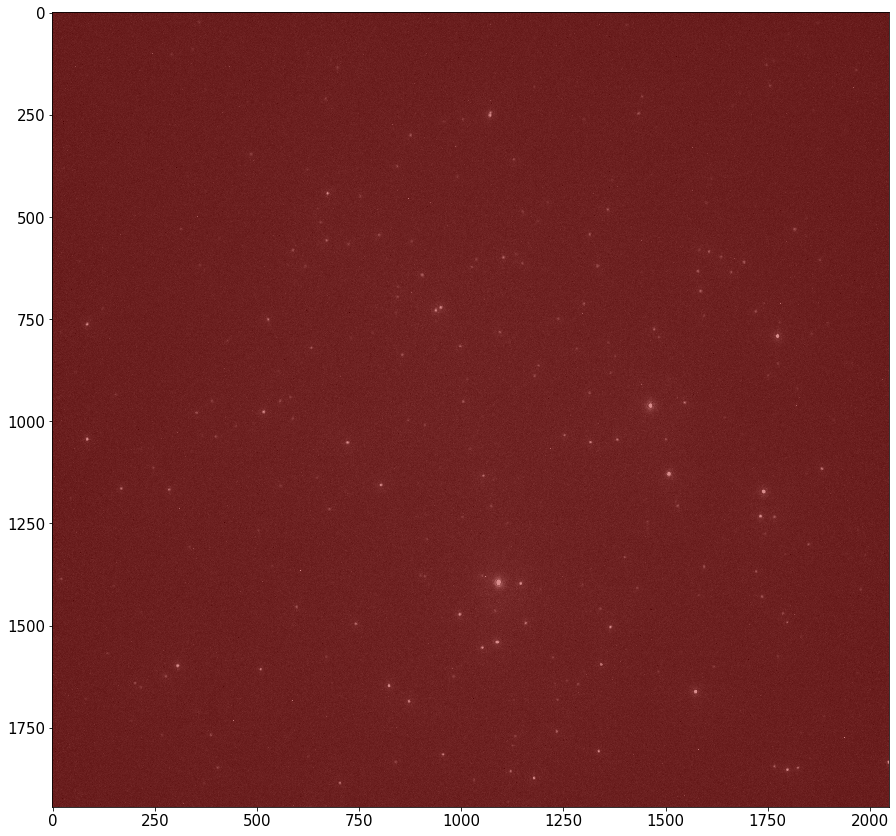

...

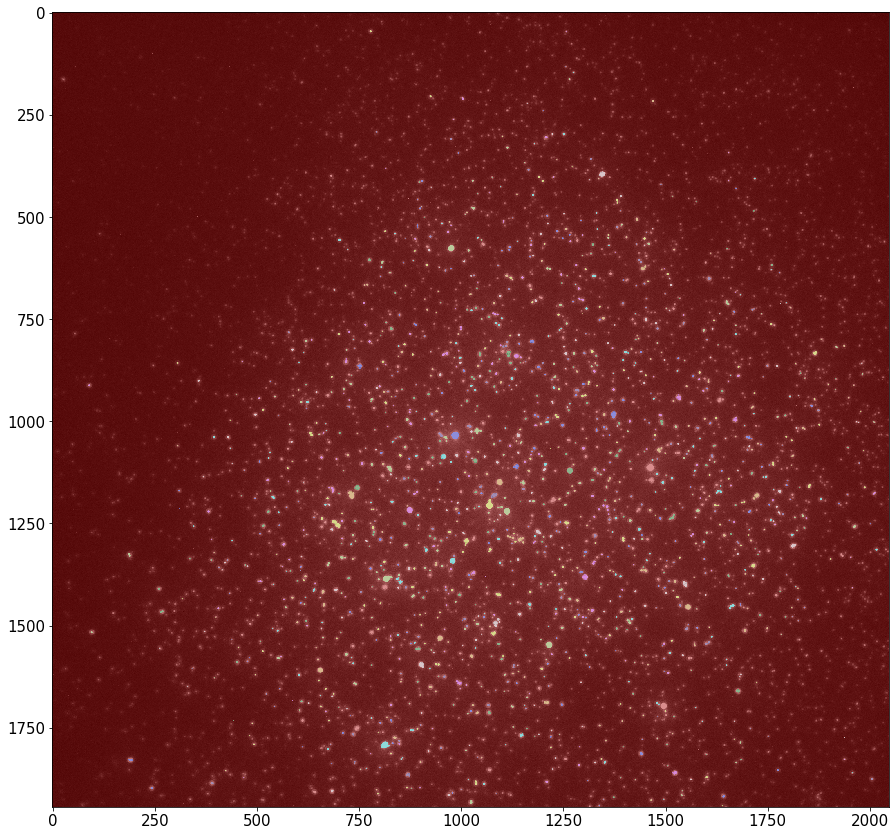

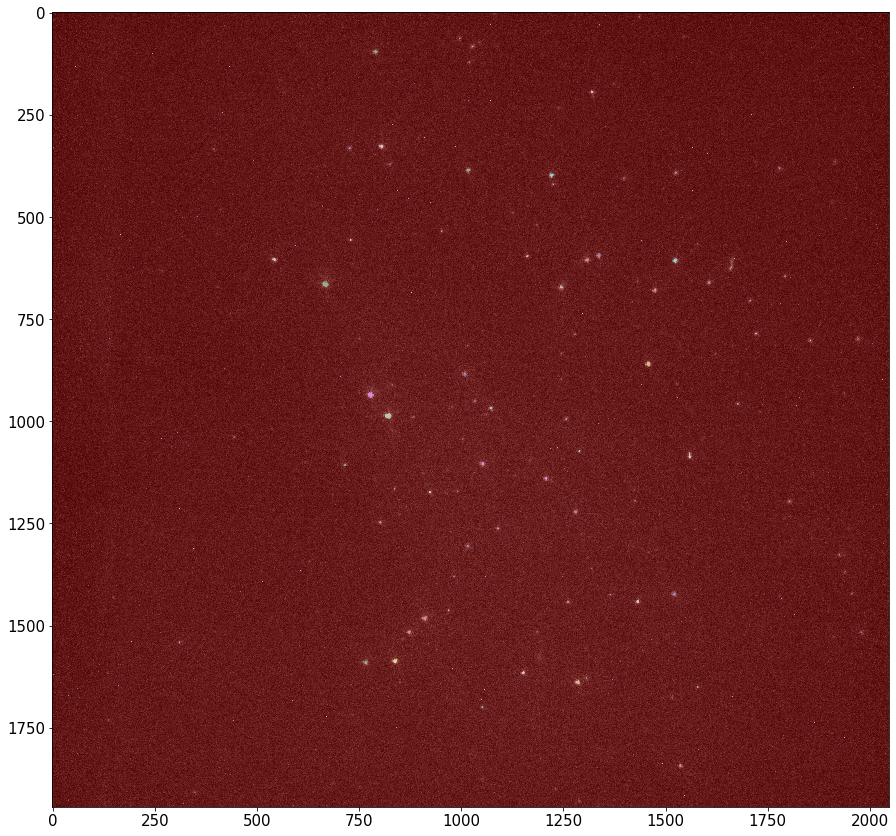

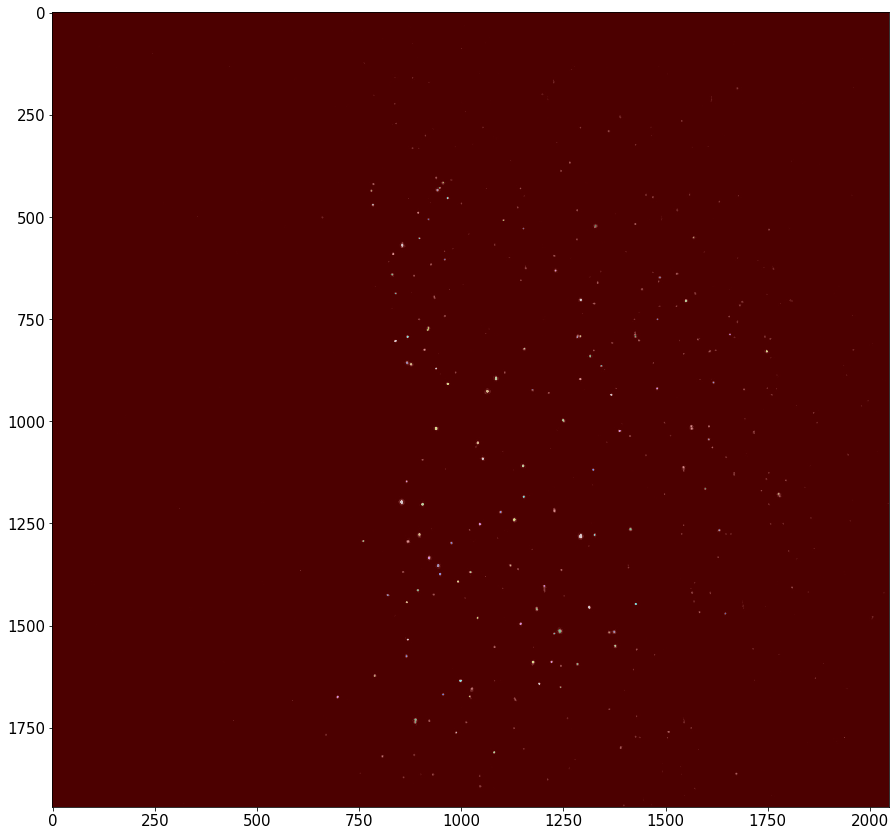

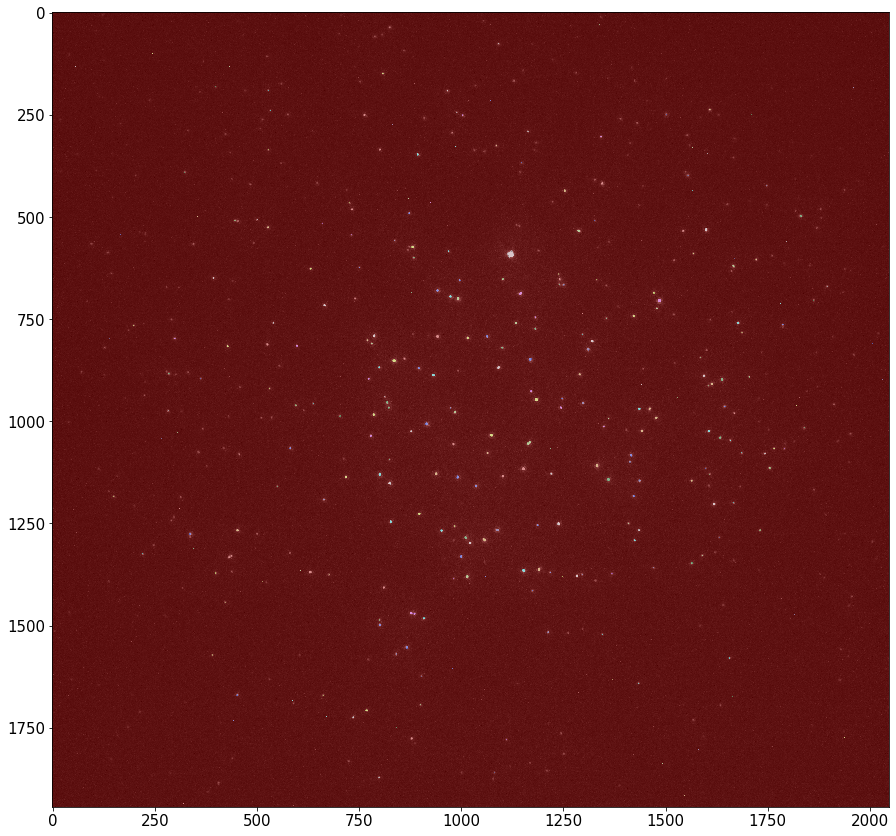

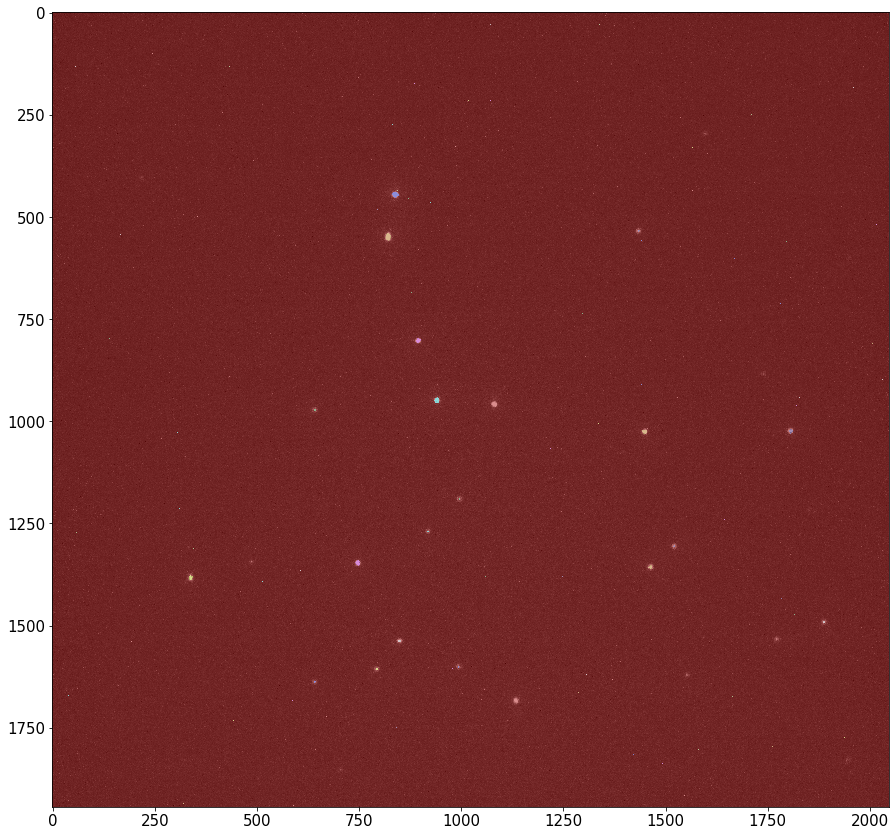

In [3]:
from skimage.filters import threshold_minimum

# iterate over all images in a certain folder
pathlist = Path('Raw data_All images/0k_29 images/minimum').glob('**/*.jpg')
for path in pathlist:
    path_in_str = str(path)
#    print(path_in_str)
    
    # open the image
    image = Image.open(path_in_str)
    
    # crop out scale bar
    width, height = image.size
    left = 0
    top = 0
    right = width
    bottom = height-100
    im1 = image.crop((left, top, right, bottom)) 
#    im1.show()
    
    # apply threshold
    img_array = np.array(im1)
    image_gray = rgb2gray(img_array)
    image = image_gray
    thresh = threshold_minimum(image)
    binary = image <= thresh
    bw = closing(image > thresh, square(3))
    plt.rcParams.update({'font.size': 15})
#    plt.figure(figsize = (15,15))
#    imshow(binary,cmap=plt.cm.gray)
    
    # remove artifacts connected to image border
    cleared = clear_border(bw)
    
    # label image regions
    label_image = label(cleared)
    image_label_overlay = label2rgb(label_image, image=image)
    fig, ax = plt.subplots(figsize=(15, 15))
    ax.imshow(image_label_overlay)
    
    # extract features
    props = regionprops(label_image,intensity_image=image_gray, coordinates='xy')
    
    for i in props: 
        # exclude circular(folded) and small(might be background noise) dots
        if i.eccentricity>.8 and i.convex_area>20:                                
            shear_rate_0k = shear_rate_0k.append({'shear rate': 0, 'eccentricity': i.eccentricity, 
                                                    'convex_area': i.convex_area,'major_axis_length': i.major_axis_length,
                                                   'minor_axis_length': i.minor_axis_length,'orientation': i.orientation},
                                                   ignore_index=True)

print("0k_29 images", shear_rate_0k, sep='\n')

In [5]:
# save dataframe
shear_rate_0k.to_pickle('shear_rate_0k')
a = pd.read_pickle('shear_rate_0k')
print(a)

     shear rate  eccentricity  convex_area  major_axis_length  \
0           0.0      0.825802         31.0           8.134746   
1           0.0      0.805504         53.0          10.428318   
2           0.0      0.837421         28.0           7.793800   
3           0.0      0.802286         31.0           7.839319   
4           0.0      0.861723         31.0           8.306929   
5           0.0      0.892727         22.0           7.595454   
6           0.0      0.876329         44.0          10.282629   
7           0.0      0.891431         61.0          12.527890   
8           0.0      0.861284         40.0           9.533924   
9           0.0      0.832255        332.0          26.420877   
10          0.0      0.800265         48.0           9.788423   
11          0.0      0.837300        238.0          22.847365   
12          0.0      0.937127         46.0          12.222895   
13          0.0      0.836409         54.0          10.947742   
14          0.0      0.85